<a href="https://colab.research.google.com/github/Kaleab1999/Medical-Transcription-for-medicne-department/blob/main/XAI_Africa3_contraceptie_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [12]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [13]:
df= pd.read_csv('/content/drive/MyDrive/Africa contraception ML/African contr.csv')
df.head()

<ipython-input-13-c5f5bfd35116>:1: DtypeWarning: Columns (1,8,11,13,18) have mixed types. Specify dtype option on import or set low_memory=False.
  df= pd.read_csv('/content/drive/MyDrive/Africa contraception ML/African contr.csv')


,Imputation_,Can read part of the sentence,Age,Listening to the radio,Ever used internet,Wanted last child then,Wanted child later or did not want more children,Currently using a method to avoid pregnancy,Ever used a method to avoid pregnancy,Wealth index quintile,Rural wealth index quintile,Received prenatal care,Place of delivery,Mother's health checked after the delivery was over,Education,Functional difficulties (age 18-49 years),Frequency of watching TV,Children ever born,Birth Skill attendent
0,0,1,1,1,2,2,1,2,2,2,3,1,23,,1,2,0,1,1
1,0,,2,1,2,2,1,1,,1,2,1,23,,2,2,0,1,1
2,0,1,6,1,2,1,2,2,2,2,4,1,22,,0,2,0,1,1
3,0,1,4,1,2,1,2,2,2,3,5,1,22,,0,2,0,1,2
4,0,1,6,0,2,1,2,2,1,3,4,1,23,,1,2,0,2,1


In [14]:
df4= df[df['Imputation_']==5]

In [15]:
df4.head()

,Imputation_,Can read part of the sentence,Age,Listening to the radio,Ever used internet,Wanted last child then,Wanted child later or did not want more children,Currently using a method to avoid pregnancy,Ever used a method to avoid pregnancy,Wealth index quintile,Rural wealth index quintile,Received prenatal care,Place of delivery,Mother's health checked after the delivery was over,Education,Functional difficulties (age 18-49 years),Frequency of watching TV,Children ever born,Birth Skill attendent
262610,5,1,1,1,0,0,1,0,0,2,3,1,23,0,1,0,0,1,1
262611,5,0,2,1,0,0,1,1,1,1,2,1,23,0,2,0,0,1,1
262612,5,1,6,1,0,1,0,0,0,2,4,1,22,0,0,0,0,1,1
262613,5,1,4,1,0,1,0,0,0,3,5,1,22,0,0,0,0,1,0
262614,5,1,6,0,0,1,0,0,1,3,4,1,23,1,1,0,0,2,1


In [16]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52522 entries, 262610 to 315131
Data columns (total 19 columns):
 #   Column                                               Non-Null Count  Dtype 
---  ------                                               --------------  ----- 
 0   Imputation_                                          52522 non-null  int64 
 1   Can read part of the sentence                        52522 non-null  object
 2   Age                                                  52522 non-null  int64 
 3   Listening to the radio                               52522 non-null  int64 
 4   Ever used internet                                   52522 non-null  int64 
 5   Wanted last child then                               52522 non-null  int64 
 6   Wanted child later or did not want more children     52522 non-null  int64 
 7   Currently using a method to avoid pregnancy          52522 non-null  int64 
 8   Ever used a method to avoid pregnancy                52522 non-null  o

#### missing values

In [17]:
su= 0
for i in df4.columns:
  if df4[i].isnull().sum()>0:
    su+=1
    print("{} has {} missing values".format(i,df4[i].isnull().sum()))

print("{} number of columns has missing values".format(su))

0 number of columns has missing values


In [18]:
df4.isnull().sum()

Imputation_                                            0
Can read part of the sentence                          0
Age                                                    0
Listening to the radio                                 0
Ever used internet                                     0
Wanted last child then                                 0
Wanted child later or did not want more children       0
Currently using a method to avoid pregnancy            0
Ever used a method to avoid pregnancy                  0
Wealth index quintile                                  0
Rural wealth index quintile                            0
Received prenatal care                                 0
Place of delivery                                      0
Mother's health checked after the delivery was over    0
Education                                              0
Functional difficulties (age 18-49 years)              0
Frequency of watching TV                               0
Children ever born             

In [19]:
df4.nunique()

Imputation_                                             1
Can read part of the sentence                           2
Age                                                     7
Listening to the radio                                  2
Ever used internet                                      2
Wanted last child then                                  2
Wanted child later or did not want more children        2
Currently using a method to avoid pregnancy             2
Ever used a method to avoid pregnancy                   2
Wealth index quintile                                   5
Rural wealth index quintile                             5
Received prenatal care                                  2
Place of delivery                                      20
Mother's health checked after the delivery was over     2
Education                                               4
Functional difficulties (age 18-49 years)               2
Frequency of watching TV                                2
Children ever 

In [20]:
df4['Can read part of the sentence'].value_counts()

1    38957
0    13565
Name: Can read part of the sentence, dtype: int64

In [21]:
df4['Ever used a method to avoid pregnancy'].value_counts()

0    46538
1     5984
Name: Ever used a method to avoid pregnancy, dtype: int64

In [22]:
df4['Received prenatal care'].value_counts()

1    44000
0     8522
Name: Received prenatal care, dtype: int64

In [23]:
df4["Mother's health checked after the delivery was over"].value_counts()

0    41517
1    11005
Name: Mother's health checked after the delivery was over, dtype: int64

In [24]:
df4["Birth Skill attendent"].value_counts()

1    32516
0    20006
Name: Birth Skill attendent, dtype: int64

In [25]:
df4['Place of delivery'].value_counts()

11    22158
22     9740
21     7579
23     6679
12     3228
31      819
41      452
32      444
96      413
33      270
26      260
36      242
42      154
99       26
24       22
35       12
34       10
43        6
76        5
          3
Name: Place of delivery, dtype: int64

In [26]:
# define the values to be replaced and their replacement values
replacements = {'96': 0, '11': 0, '12': 0, '99': 0, 
                '21': 1, '22': 1, '23': 1, '24': 1,
                '26': 1, '31': 1, '32': 1, '33': 1,
                '34': 1, '35': 1, '36': 1, '41': 1,
                '42': 1, '43': 1, '76': 1, ' ': 1}

# replace values using the replace method and specify 'inplace=False'
df4['Place of delivery'] = df4['Place of delivery'].replace(replacements, inplace=False)

<ipython-input-26-ed6431e8a917>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4['Place of delivery'] = df4['Place of delivery'].replace(replacements, inplace=False)


In [27]:
df4.head()

,Imputation_,Can read part of the sentence,Age,Listening to the radio,Ever used internet,Wanted last child then,Wanted child later or did not want more children,Currently using a method to avoid pregnancy,Ever used a method to avoid pregnancy,Wealth index quintile,Rural wealth index quintile,Received prenatal care,Place of delivery,Mother's health checked after the delivery was over,Education,Functional difficulties (age 18-49 years),Frequency of watching TV,Children ever born,Birth Skill attendent
262610,5,1,1,1,0,0,1,0,0,2,3,1,1,0,1,0,0,1,1
262611,5,0,2,1,0,0,1,1,1,1,2,1,1,0,2,0,0,1,1
262612,5,1,6,1,0,1,0,0,0,2,4,1,1,0,0,0,0,1,1
262613,5,1,4,1,0,1,0,0,0,3,5,1,1,0,0,0,0,1,0
262614,5,1,6,0,0,1,0,0,1,3,4,1,1,1,1,0,0,2,1


# remove common values (i.e., imputations)

In [28]:
df4.drop(['Imputation_'], axis=1, inplace=True)

<ipython-input-28-259e89279ca7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4.drop(['Imputation_'], axis=1, inplace=True)


In [29]:
df4.head()

,Can read part of the sentence,Age,Listening to the radio,Ever used internet,Wanted last child then,Wanted child later or did not want more children,Currently using a method to avoid pregnancy,Ever used a method to avoid pregnancy,Wealth index quintile,Rural wealth index quintile,Received prenatal care,Place of delivery,Mother's health checked after the delivery was over,Education,Functional difficulties (age 18-49 years),Frequency of watching TV,Children ever born,Birth Skill attendent
262610,1,1,1,0,0,1,0,0,2,3,1,1,0,1,0,0,1,1
262611,0,2,1,0,0,1,1,1,1,2,1,1,0,2,0,0,1,1
262612,1,6,1,0,1,0,0,0,2,4,1,1,0,0,0,0,1,1
262613,1,4,1,0,1,0,0,0,3,5,1,1,0,0,0,0,1,0
262614,1,6,0,0,1,0,0,1,3,4,1,1,1,1,0,0,2,1


In [30]:
df4['Can read part of the sentence'] = df4['Can read part of the sentence'].astype(int)
df4['Ever used a method to avoid pregnancy'] = df4['Ever used a method to avoid pregnancy'].astype(int)
df4['Received prenatal care'] = df4['Received prenatal care'].astype(int)
df4["Mother's health checked after the delivery was over"] = df4["Mother's health checked after the delivery was over"].astype(int)
df4['Birth Skill attendent'] = df4['Birth Skill attendent'].astype(int)
df4['Place of delivery'] = df4['Place of delivery'].astype(int)

<ipython-input-30-1e1dc18d3adb>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4['Can read part of the sentence'] = df4['Can read part of the sentence'].astype(int)
<ipython-input-30-1e1dc18d3adb>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4['Ever used a method to avoid pregnancy'] = df4['Ever used a method to avoid pregnancy'].astype(int)
<ipython-input-30-1e1dc18d3adb>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_

In [31]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52522 entries, 262610 to 315131
Data columns (total 18 columns):
 #   Column                                               Non-Null Count  Dtype
---  ------                                               --------------  -----
 0   Can read part of the sentence                        52522 non-null  int64
 1   Age                                                  52522 non-null  int64
 2   Listening to the radio                               52522 non-null  int64
 3   Ever used internet                                   52522 non-null  int64
 4   Wanted last child then                               52522 non-null  int64
 5   Wanted child later or did not want more children     52522 non-null  int64
 6   Currently using a method to avoid pregnancy          52522 non-null  int64
 7   Ever used a method to avoid pregnancy                52522 non-null  int64
 8   Wealth index quintile                                52522 non-null  int64
 9   

In [32]:
y= list(df4['Currently using a method to avoid pregnancy'])
df4.drop(['Currently using a method to avoid pregnancy'],axis=1, inplace=True)

<ipython-input-32-1d7cff8ca81b>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4.drop(['Currently using a method to avoid pregnancy'],axis=1, inplace=True)


In [33]:
df4.head()

,Can read part of the sentence,Age,Listening to the radio,Ever used internet,Wanted last child then,Wanted child later or did not want more children,Ever used a method to avoid pregnancy,Wealth index quintile,Rural wealth index quintile,Received prenatal care,Place of delivery,Mother's health checked after the delivery was over,Education,Functional difficulties (age 18-49 years),Frequency of watching TV,Children ever born,Birth Skill attendent
262610,1,1,1,0,0,1,0,2,3,1,1,0,1,0,0,1,1
262611,0,2,1,0,0,1,1,1,2,1,1,0,2,0,0,1,1
262612,1,6,1,0,1,0,0,2,4,1,1,0,0,0,0,1,1
262613,1,4,1,0,1,0,0,3,5,1,1,0,0,0,0,1,0
262614,1,6,0,0,1,0,1,3,4,1,1,1,1,0,0,2,1


In [34]:
X= df4.to_numpy()
y= np.array(y)

In [35]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size=0.1)

In [36]:
X_train1, X_val, y_train1, y_val= train_test_split(X_train, y_train, test_size=0.1, stratify=y_train)

In [37]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_train1, y_train1 = smote.fit_resample(X_train, y_train)

In [38]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [39]:
model = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(X_train1, y_train1, epochs=10, batch_size=32)


Epoch 1/10
2232/2232 [==============================] - 16s 5ms/step - loss: 0.6280 - accuracy: 0.6471
Epoch 2/10
2232/2232 [==============================] - 10s 5ms/step - loss: 0.6160 - accuracy: 0.6579
Epoch 3/10
2232/2232 [==============================] - 8s 3ms/step - loss: 0.6105 - accuracy: 0.6637
Epoch 4/10
2232/2232 [==============================] - 9s 4ms/step - loss: 0.6062 - accuracy: 0.6690
Epoch 5/10
2232/2232 [==============================] - 7s 3ms/step - loss: 0.6030 - accuracy: 0.6726
Epoch 6/10
2232/2232 [==============================] - 8s 4ms/step - loss: 0.5986 - accuracy: 0.6753
Epoch 7/10
2232/2232 [==============================] - 8s 3ms/step - loss: 0.5960 - accuracy: 0.6776
Epoch 8/10
2232/2232 [==============================] - 8s 4ms/step - loss: 0.5919 - accuracy: 0.6825
Epoch 9/10
2232/2232 [==============================] - 8s 4ms/step - loss: 0.5885 - accuracy: 0.6847
Epoch 10/10
2232/2232 [==============================] - 7s 3ms/step - loss: 0.5

165/165 [==============================] - 1s 3ms/step - loss: 0.6178 - accuracy: 0.6684
Test accuracy: 0.6683799624443054
Epoch 1/20
2232/2232 [==============================] - 8s 3ms/step - loss: 0.5822 - accuracy: 0.6911 - val_loss: 0.5569 - val_accuracy: 0.7241
Epoch 2/20
2232/2232 [==============================] - 9s 4ms/step - loss: 0.5786 - accuracy: 0.6931 - val_loss: 0.5562 - val_accuracy: 0.7222
Epoch 3/20
2232/2232 [==============================] - 8s 4ms/step - loss: 0.5752 - accuracy: 0.6978 - val_loss: 0.5589 - val_accuracy: 0.7095
Epoch 4/20
2232/2232 [==============================] - 8s 4ms/step - loss: 0.5719 - accuracy: 0.7005 - val_loss: 0.5749 - val_accuracy: 0.6937
Epoch 5/20
2232/2232 [==============================] - 9s 4ms/step - loss: 0.5687 - accuracy: 0.7014 - val_loss: 0.5635 - val_accuracy: 0.7239
Epoch 6/20
2232/2232 [==============================] - 8s 3ms/step - loss: 0.5655 - accuracy: 0.7050 - val_loss: 0.5533 - val_accuracy: 0.7191
Epoch 7/20
22

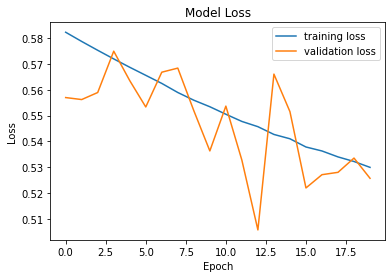

In [40]:
# Evaluate the model on the testing dataset
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

# Plot the structure of the model
keras.utils.plot_model(model, show_shapes=True)

# Plot the loss of the model during training
import matplotlib.pyplot as plt

history = model.fit(X_train1, y_train1, epochs=20, batch_size=32, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


165/165 [==============================] - 1s 3ms/step
              precision    recall  f1-score   support

           0       0.83      0.71      0.76      3924
           1       0.40      0.57      0.47      1329

    accuracy                           0.67      5253
   macro avg       0.61      0.64      0.62      5253
weighted avg       0.72      0.67      0.69      5253



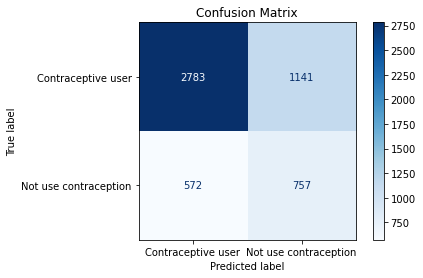

In [49]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [50]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                1152      
                                                                 
 dense_1 (Dense)             (None, 64)                4160      
                                                                 
 dense_2 (Dense)             (None, 64)                4160      
                                                                 
 dense_3 (Dense)             (None, 1)                 65        
                                                                 
Total params: 9,537
Trainable params: 9,537
Non-trainable params: 0
_________________________________________________________________


In [ ]:
!pip install shap

[[1 3 1 0 0 0 1 3 4 1 1 0 0 0 0 1 1]]


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


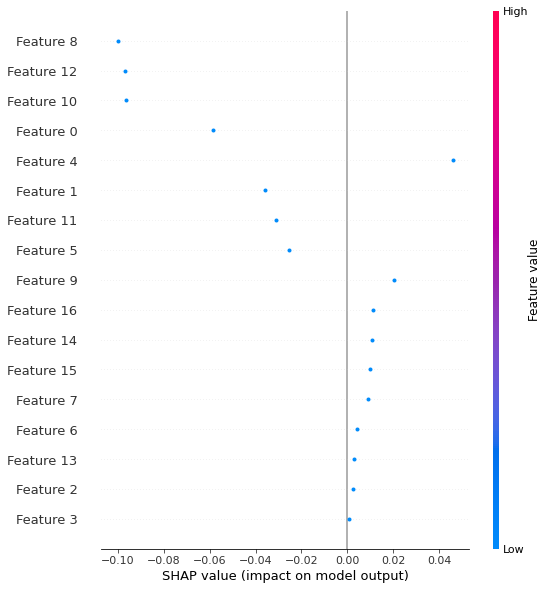

In [54]:
import shap
# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model, background)
shap_values = explainer(X_train1[0:1])
print(background[0:1])
# Plot the SHAP values
shap.summary_plot(shap_values)

In [ ]:
!pip install lime

In [64]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 1s 3ms/step


In [65]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


165/165 [==============================] - 1s 3ms/step - loss: 0.6280 - accuracy: 0.6739
Test accuracy: 0.6739006042480469
Epoch 1/100
1116/1116 [==============================] - 6s 6ms/step - loss: 0.5152 - accuracy: 0.7423 - val_loss: 0.5215 - val_accuracy: 0.7341
Epoch 2/100
1116/1116 [==============================] - 7s 6ms/step - loss: 0.5147 - accuracy: 0.7406 - val_loss: 0.5231 - val_accuracy: 0.7385
Epoch 3/100
1116/1116 [==============================] - 8s 7ms/step - loss: 0.5140 - accuracy: 0.7426 - val_loss: 0.5110 - val_accuracy: 0.7438
Epoch 4/100
1116/1116 [==============================] - 6s 5ms/step - loss: 0.5123 - accuracy: 0.7433 - val_loss: 0.5216 - val_accuracy: 0.7438
Epoch 5/100
1116/1116 [==============================] - 5s 5ms/step - loss: 0.5111 - accuracy: 0.7440 - val_loss: 0.5027 - val_accuracy: 0.7506
Epoch 6/100
1116/1116 [==============================] - 4s 4ms/step - loss: 0.5096 - accuracy: 0.7445 - val_loss: 0.5173 - val_accuracy: 0.7415
Epoch 7

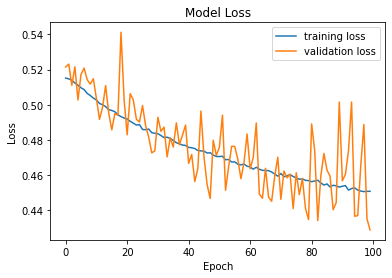

In [66]:
# Evaluate the model on the testing dataset
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

# Plot the structure of the model
keras.utils.plot_model(model, show_shapes=True)

# Plot the loss of the model during training
import matplotlib.pyplot as plt

history = model.fit(X_train1, y_train1, epochs=100, batch_size=64, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


165/165 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.81      0.75      0.78      3924
           1       0.40      0.50      0.44      1329

    accuracy                           0.68      5253
   macro avg       0.61      0.62      0.61      5253
weighted avg       0.71      0.68      0.69      5253



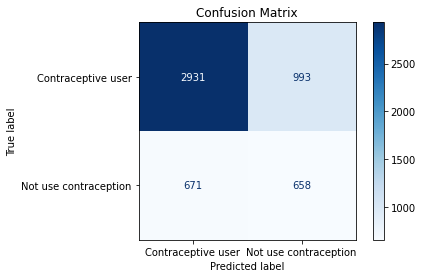

In [68]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [69]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [70]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [71]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                1152      
                                                                 
 dense_1 (Dense)             (None, 64)                4160      
                                                                 
 dense_2 (Dense)             (None, 64)                4160      
                                                                 
 dense_3 (Dense)             (None, 1)                 65        
                                                                 
Total params: 9,537
Trainable params: 9,537
Non-trainable params: 0
_________________________________________________________________


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


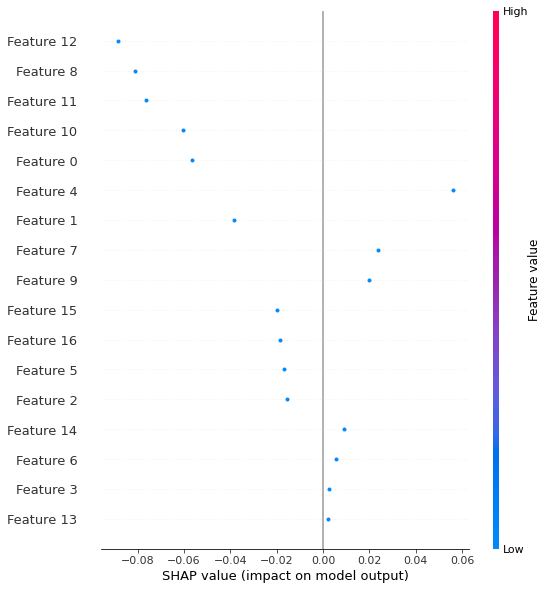

In [72]:
import shap
# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

In [73]:
from tensorflow.keras.layers import Layer

class PRelu(Layer):
    def __init__(self, alpha_initializer='zeros', **kwargs):
        super(PRelu, self).__init__(**kwargs)
        self.alpha_initializer = keras.initializers.get(alpha_initializer)

    def build(self, input_shape):
        self.alpha = self.add_weight(shape=(input_shape[-1],),
                                     initializer=self.alpha_initializer,
                                     trainable=True,
                                     name='alpha')
        super(PRelu, self).build(input_shape)

    def call(self, inputs):
        pos = keras.activations.relu(inputs)
        neg = self.alpha * (inputs - abs(inputs)) * 0.5
        return pos + neg

    def get_config(self):
        config = super(PRelu, self).get_config()
        config.update({'alpha_initializer': keras.initializers.serialize(self.alpha_initializer)})
        return config


Epoch 1/20
1116/1116 [==============================] - 6s 4ms/step - loss: 0.6327 - accuracy: 0.6428 - val_loss: 0.6248 - val_accuracy: 0.6507
Epoch 2/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6192 - accuracy: 0.6543 - val_loss: 0.5864 - val_accuracy: 0.6973
Epoch 3/20
1116/1116 [==============================] - 7s 7ms/step - loss: 0.6136 - accuracy: 0.6603 - val_loss: 0.6554 - val_accuracy: 0.6319
Epoch 4/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6097 - accuracy: 0.6630 - val_loss: 0.5815 - val_accuracy: 0.7078
Epoch 5/20
1116/1116 [==============================] - 6s 6ms/step - loss: 0.6068 - accuracy: 0.6662 - val_loss: 0.6174 - val_accuracy: 0.6564
Epoch 6/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6046 - accuracy: 0.6695 - val_loss: 0.6272 - val_accuracy: 0.6619
Epoch 7/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6021 - accuracy: 0.6707 - val_loss: 0.6244 - val_accuracy:

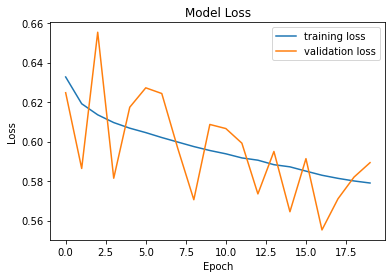

In [74]:
from tensorflow.keras import layers, mixed_precision
from tensorflow.keras.layers import PReLU

# Enable mixed precision training
mixed_precision.set_global_policy('mixed_float16')
model_bf = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  #layers.Dense(64),
  #PRelu(),
  layers.Dense(1, activation='sigmoid')
])

# Use mixed precision optimizer
optimizer = tf.keras.optimizers.Adam()

# Use mixed precision loss and metrics
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
metric_list = [tf.keras.metrics.BinaryAccuracy(dtype='float32')]


model_bf.compile(optimizer='adam',
                 loss='binary_crossentropy',
                 metrics=['accuracy'])

history = model_bf.fit(X_train1, y_train1, epochs=20, batch_size=64, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [75]:
model_bf.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 64)                1152      
                                                                 
 dense_5 (Dense)             (None, 64)                4160      
                                                                 
 dense_6 (Dense)             (None, 1)                 65        
                                                                 
Total params: 5,377
Trainable params: 5,377
Non-trainable params: 0
_________________________________________________________________


165/165 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.84      0.66      0.74      3924
           1       0.39      0.64      0.48      1329

    accuracy                           0.65      5253
   macro avg       0.62      0.65      0.61      5253
weighted avg       0.73      0.65      0.67      5253



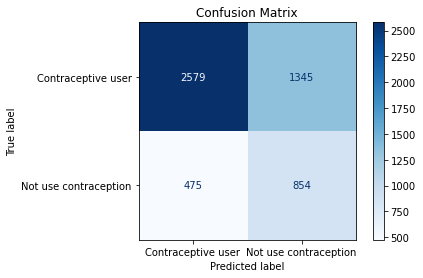

In [76]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_bf.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [77]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [78]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


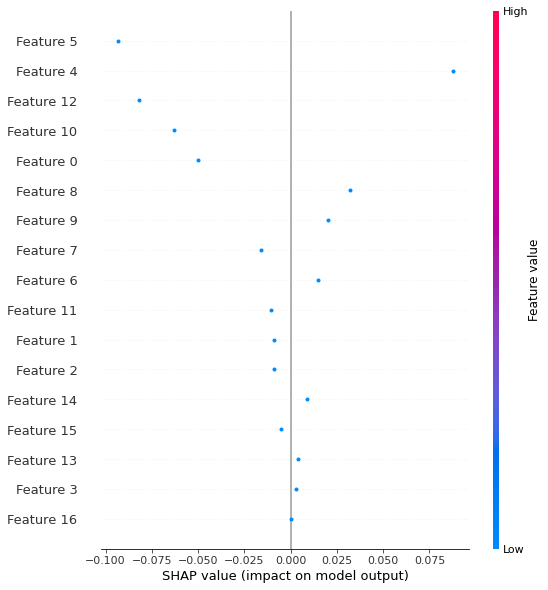

In [80]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_bf, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

Epoch 1/20
1116/1116 [==============================] - 8s 6ms/step - loss: 0.6288 - accuracy: 0.6470 - val_loss: 0.5881 - val_accuracy: 0.7040
Epoch 2/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6162 - accuracy: 0.6583 - val_loss: 0.6140 - val_accuracy: 0.6765
Epoch 3/20
1116/1116 [==============================] - 10s 9ms/step - loss: 0.6107 - accuracy: 0.6623 - val_loss: 0.5824 - val_accuracy: 0.7062
Epoch 4/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6071 - accuracy: 0.6660 - val_loss: 0.6054 - val_accuracy: 0.6861
Epoch 5/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.6033 - accuracy: 0.6713 - val_loss: 0.5630 - val_accuracy: 0.7127
Epoch 6/20
1116/1116 [==============================] - 6s 5ms/step - loss: 0.5992 - accuracy: 0.6752 - val_loss: 0.5925 - val_accuracy: 0.6825
Epoch 7/20
1116/1116 [==============================] - 5s 5ms/step - loss: 0.5954 - accuracy: 0.6788 - val_loss: 0.6122 - val_accuracy

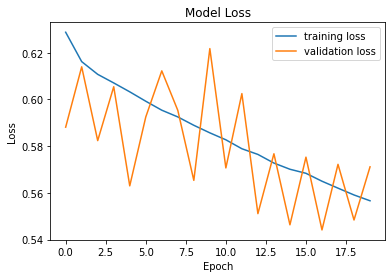

In [81]:
from tensorflow.keras import layers, mixed_precision
from tensorflow.keras.layers import PReLU

# Enable mixed precision training
mixed_precision.set_global_policy('mixed_float16')
model_bf = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  #layers.Dense(32, activation='relu'),
  layers.Dense(64),
  PRelu(),
  layers.Dense(1, activation='sigmoid')
])

# Use mixed precision optimizer
optimizer = tf.keras.optimizers.Adam()

# Use mixed precision loss and metrics
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
metric_list = [tf.keras.metrics.BinaryAccuracy(dtype='float32')]


model_bf.compile(optimizer='adam',
                 loss='binary_crossentropy',
                 metrics=['accuracy'])

history = model_bf.fit(X_train1, y_train1, epochs=20, batch_size=64, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [82]:
model_bf.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_7 (Dense)             (None, 64)                1152      
                                                                 
 dense_8 (Dense)             (None, 64)                4160      
                                                                 
 dense_9 (Dense)             (None, 64)                4160      
                                                                 
 p_relu (PRelu)              (None, 64)                64        
                                                                 
 dense_10 (Dense)            (None, 1)                 65        
                                                                 
Total params: 9,601
Trainable params: 9,601
Non-trainable params: 0
_________________________________________________________________


165/165 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.85      0.65      0.74      3924
           1       0.39      0.66      0.49      1329

    accuracy                           0.65      5253
   macro avg       0.62      0.65      0.61      5253
weighted avg       0.73      0.65      0.67      5253



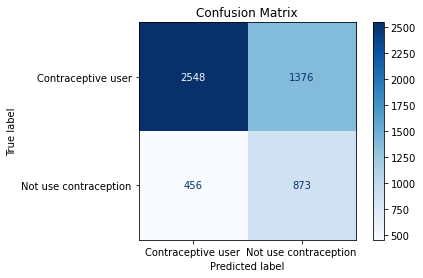

In [83]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_bf.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [84]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [85]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 3ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


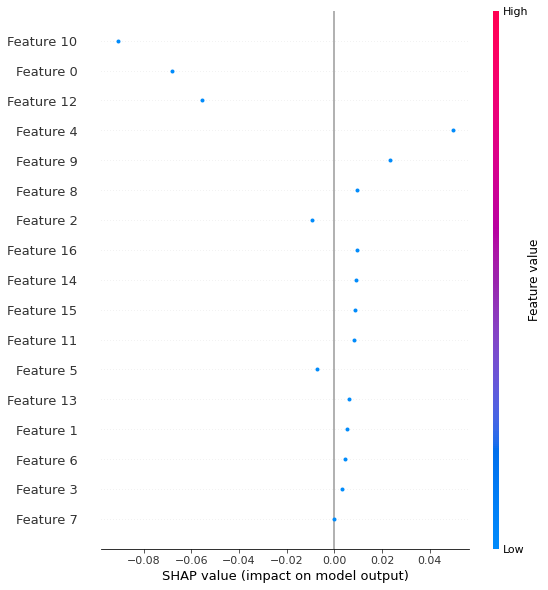

In [86]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_bf, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

In [87]:
from sklearn.feature_selection import SelectKBest, chi2, RFE
selector = SelectKBest(score_func=chi2, k=9)  # Choose your desired feature selection method and set the number of features to select
X_selected = selector.fit_transform(X, y)  # Apply feature selection to the original features

# Print the indices of the selected features
print(selector.get_support(indices=True))

[ 0  2  6  7  9 10 12 14 16]


In [89]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test= train_test_split(X_selected, y, test_size=0.1)

In [90]:
X_train1, X_val, y_train1, y_val= train_test_split(X_train, y_train, test_size=0.1, stratify=y_train)

In [91]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_train1, y_train1 = smote.fit_resample(X_train, y_train)

In [92]:
model = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(X_train1, y_train1, epochs=10, batch_size=32)


Epoch 1/10
2225/2225 [==============================] - 12s 5ms/step - loss: 0.6302 - accuracy: 0.6452
Epoch 2/10
2225/2225 [==============================] - 16s 7ms/step - loss: 0.6237 - accuracy: 0.6522
Epoch 3/10
2225/2225 [==============================] - 10s 4ms/step - loss: 0.6213 - accuracy: 0.6545
Epoch 4/10
2225/2225 [==============================] - 12s 5ms/step - loss: 0.6197 - accuracy: 0.6563
Epoch 5/10
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6182 - accuracy: 0.6585
Epoch 6/10
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6175 - accuracy: 0.6584
Epoch 7/10
2225/2225 [==============================] - 10s 5ms/step - loss: 0.6168 - accuracy: 0.6605
Epoch 8/10
2225/2225 [==============================] - 10s 5ms/step - loss: 0.6156 - accuracy: 0.6606
Epoch 9/10
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6151 - accuracy: 0.6616
Epoch 10/10
2225/2225 [==============================] - 11s 5ms/step - l

165/165 [==============================] - 1s 2ms/step - loss: 0.6506 - accuracy: 0.6358
Test accuracy: 0.6358271241188049
Epoch 1/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6138 - accuracy: 0.6623 - val_loss: 0.5969 - val_accuracy: 0.6920
Epoch 2/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6135 - accuracy: 0.6635 - val_loss: 0.6347 - val_accuracy: 0.6440
Epoch 3/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6129 - accuracy: 0.6629 - val_loss: 0.6087 - val_accuracy: 0.6772
Epoch 4/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6123 - accuracy: 0.6644 - val_loss: 0.5972 - val_accuracy: 0.6842
Epoch 5/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6118 - accuracy: 0.6648 - val_loss: 0.6057 - val_accuracy: 0.6708
Epoch 6/20
2225/2225 [==============================] - 11s 5ms/step - loss: 0.6113 - accuracy: 0.6646 - val_loss: 0.6173 - val_accuracy: 0.6801
Epoch 7

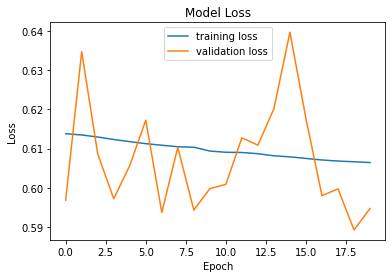

In [93]:
# Evaluate the model on the testing dataset
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

# Plot the structure of the model
keras.utils.plot_model(model, show_shapes=True)

# Plot the loss of the model during training
import matplotlib.pyplot as plt

history = model.fit(X_train1, y_train1, epochs=20, batch_size=32, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


165/165 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.85      0.66      0.74      4036
           1       0.35      0.62      0.45      1217

    accuracy                           0.65      5253
   macro avg       0.60      0.64      0.60      5253
weighted avg       0.74      0.65      0.67      5253



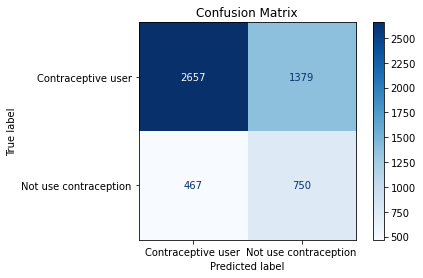

In [104]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [105]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [106]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 1s 3ms/step


In [107]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 64)                640       
                                                                 
 dense_12 (Dense)            (None, 64)                4160      
                                                                 
 dense_13 (Dense)            (None, 64)                4160      
                                                                 
 dense_14 (Dense)            (None, 1)                 65        
                                                                 
Total params: 9,025
Trainable params: 9,025
Non-trainable params: 0
_________________________________________________________________


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


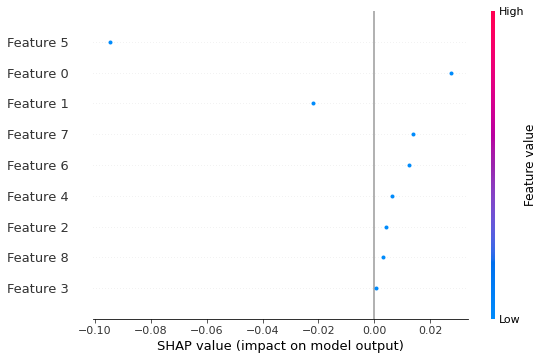

In [108]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

Epoch 1/20
1113/1113 [==============================] - 7s 5ms/step - loss: 0.6310 - accuracy: 0.6459 - val_loss: 0.6377 - val_accuracy: 0.6376
Epoch 2/20
1113/1113 [==============================] - 6s 6ms/step - loss: 0.6239 - accuracy: 0.6527 - val_loss: 0.6231 - val_accuracy: 0.6679
Epoch 3/20
1113/1113 [==============================] - 6s 6ms/step - loss: 0.6218 - accuracy: 0.6546 - val_loss: 0.6151 - val_accuracy: 0.6522
Epoch 4/20
1113/1113 [==============================] - 6s 6ms/step - loss: 0.6204 - accuracy: 0.6559 - val_loss: 0.6443 - val_accuracy: 0.6251
Epoch 5/20
1113/1113 [==============================] - 6s 6ms/step - loss: 0.6199 - accuracy: 0.6559 - val_loss: 0.5999 - val_accuracy: 0.6797
Epoch 6/20
1113/1113 [==============================] - 10s 9ms/step - loss: 0.6192 - accuracy: 0.6577 - val_loss: 0.5995 - val_accuracy: 0.6892
Epoch 7/20
1113/1113 [==============================] - 6s 6ms/step - loss: 0.6187 - accuracy: 0.6578 - val_loss: 0.6506 - val_accuracy

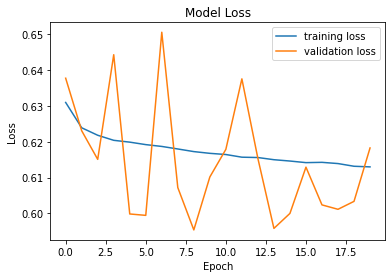

In [109]:
from tensorflow.keras import layers, mixed_precision
from tensorflow.keras.layers import PReLU

# Enable mixed precision training
mixed_precision.set_global_policy('mixed_float16')
model_bf = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  #layers.Dense(64),
  #PRelu(),
  layers.Dense(1, activation='sigmoid')
])

# Use mixed precision optimizer
optimizer = tf.keras.optimizers.Adam()

# Use mixed precision loss and metrics
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
metric_list = [tf.keras.metrics.BinaryAccuracy(dtype='float32')]


model_bf.compile(optimizer='adam',
                 loss='binary_crossentropy',
                 metrics=['accuracy'])

history = model_bf.fit(X_train1, y_train1, epochs=20, batch_size=64, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [110]:
model_bf.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            (None, 64)                640       
                                                                 
 dense_16 (Dense)            (None, 64)                4160      
                                                                 
 dense_17 (Dense)            (None, 1)                 65        
                                                                 
Total params: 4,865
Trainable params: 4,865
Non-trainable params: 0
_________________________________________________________________


165/165 [==============================] - 0s 1ms/step
              precision    recall  f1-score   support

           0       0.86      0.65      0.74      4036
           1       0.36      0.64      0.46      1217

    accuracy                           0.65      5253
   macro avg       0.61      0.64      0.60      5253
weighted avg       0.74      0.65      0.67      5253



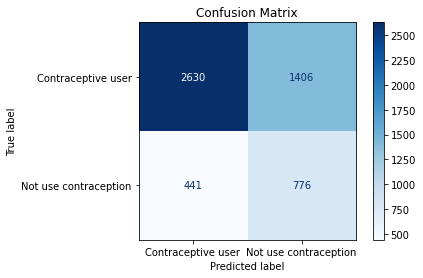

In [111]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_bf.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [112]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [113]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_bf.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 1s 5ms/step


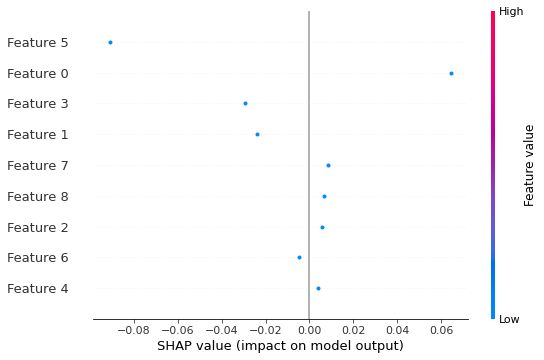

In [115]:
# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_bf, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

In [194]:
X= df4.to_numpy()
y= np.array(y)

In [195]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size=0.1)

In [196]:
X_train1, X_val, y_train1, y_val= train_test_split(X_train, y_train, test_size=0.1, stratify=y_train)

In [197]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_train1, y_train1 = smote.fit_resample(X_train, y_train)

In [120]:
# Scale the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train1 = scaler.fit_transform(X_train1)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

In [121]:
model = keras.Sequential([
  layers.Dense(64, activation='relu'),
  layers.Dense(64, activation='relu'),
  #layers.Dense(64, activation='relu'),
  layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(X_train1, y_train1, epochs=10, batch_size=32)


Epoch 1/10
2230/2230 [==============================] - 11s 4ms/step - loss: 0.6217 - accuracy: 0.6528
Epoch 2/10
2230/2230 [==============================] - 9s 4ms/step - loss: 0.6087 - accuracy: 0.6649
Epoch 3/10
2230/2230 [==============================] - 10s 4ms/step - loss: 0.6024 - accuracy: 0.6731
Epoch 4/10
2230/2230 [==============================] - 10s 4ms/step - loss: 0.5980 - accuracy: 0.6760
Epoch 5/10
2230/2230 [==============================] - 9s 4ms/step - loss: 0.5939 - accuracy: 0.6801
Epoch 6/10
2230/2230 [==============================] - 12s 5ms/step - loss: 0.5897 - accuracy: 0.6835
Epoch 7/10
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5867 - accuracy: 0.6861
Epoch 8/10
2230/2230 [==============================] - 9s 4ms/step - loss: 0.5831 - accuracy: 0.6882
Epoch 9/10
2230/2230 [==============================] - 14s 6ms/step - loss: 0.5791 - accuracy: 0.6919
Epoch 10/10
2230/2230 [==============================] - 11s 5ms/step - loss

165/165 [==============================] - 1s 2ms/step - loss: 0.6304 - accuracy: 0.6560
Test accuracy: 0.6560060977935791
Epoch 1/30
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5738 - accuracy: 0.6969 - val_loss: 0.5459 - val_accuracy: 0.7296
Epoch 2/30
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5712 - accuracy: 0.6983 - val_loss: 0.5651 - val_accuracy: 0.7098
Epoch 3/30
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5687 - accuracy: 0.6997 - val_loss: 0.5576 - val_accuracy: 0.7163
Epoch 4/30
2230/2230 [==============================] - 9s 4ms/step - loss: 0.5663 - accuracy: 0.7025 - val_loss: 0.5799 - val_accuracy: 0.6945
Epoch 5/30
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5645 - accuracy: 0.7053 - val_loss: 0.5554 - val_accuracy: 0.7195
Epoch 6/30
2230/2230 [==============================] - 11s 5ms/step - loss: 0.5625 - accuracy: 0.7065 - val_loss: 0.5444 - val_accuracy: 0.7239
Epoch 7/

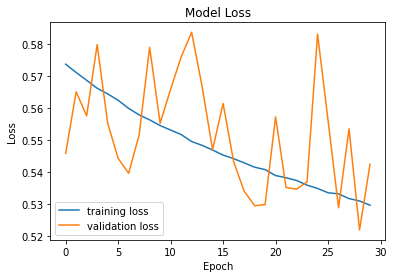

In [122]:
# Evaluate the model on the testing dataset
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

# Plot the structure of the model
keras.utils.plot_model(model, show_shapes=True)

# Plot the loss of the model during training
import matplotlib.pyplot as plt

history = model.fit(X_train1, y_train1, epochs=30, batch_size=32, validation_data=(X_val, y_val))

plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


165/165 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

           0       0.84      0.68      0.75      3963
           1       0.38      0.61      0.47      1290

    accuracy                           0.66      5253
   macro avg       0.61      0.64      0.61      5253
weighted avg       0.73      0.66      0.68      5253



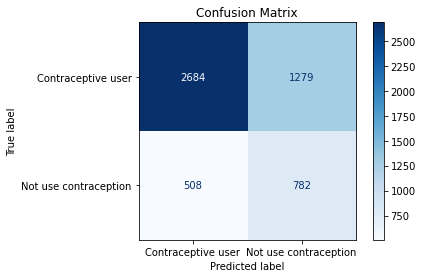

In [128]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [129]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [130]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [131]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_18 (Dense)            (None, 64)                1152      
                                                                 
 dense_19 (Dense)            (None, 64)                4160      
                                                                 
 dense_20 (Dense)            (None, 1)                 65        
                                                                 
Total params: 5,377
Trainable params: 5,377
Non-trainable params: 0
_________________________________________________________________


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


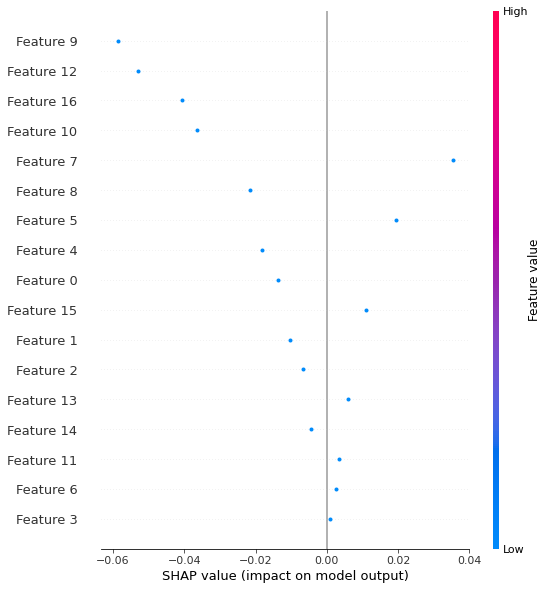

In [132]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

Epoch 1/2
8917/8917 [==============================] - 41s 4ms/step - loss: 0.6197 - accuracy: 0.6563 - val_loss: 0.6278 - val_accuracy: 0.6605
Epoch 2/2
8917/8917 [==============================] - 38s 4ms/step - loss: 0.6077 - accuracy: 0.6673 - val_loss: 0.5881 - val_accuracy: 0.6920


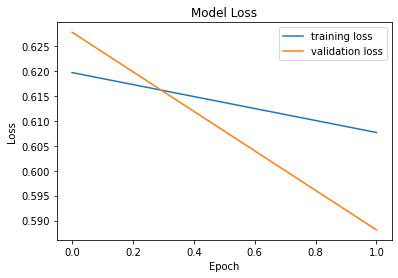

In [142]:
model_ann = keras.Sequential([
  layers.Dense(64, activation='relu', dtype=tf.float32),
  layers.Dense(64, activation='relu', dtype=tf.float32),
  #layers.Dense(64, activation='relu', dtype=tf.float32),
  layers.Dense(1, activation='sigmoid', dtype=tf.float32)
])

# Compile the model
model_ann.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history_ann = model_ann.fit(X_train1, y_train1, epochs=2, batch_size=8, validation_data=(X_val, y_val))

plt.plot(history_ann.history['loss'], label='training loss')
plt.plot(history_ann.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [143]:
model_ann.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_27 (Dense)            (None, 64)                1152      
                                                                 
 dense_28 (Dense)            (None, 64)                4160      
                                                                 
 dense_29 (Dense)            (None, 1)                 65        
                                                                 
Total params: 5,377
Trainable params: 5,377
Non-trainable params: 0
_________________________________________________________________


165/165 [==============================] - 0s 1ms/step
              precision    recall  f1-score   support

           0       0.84      0.71      0.77      3963
           1       0.39      0.59      0.47      1290

    accuracy                           0.68      5253
   macro avg       0.62      0.65      0.62      5253
weighted avg       0.73      0.68      0.69      5253



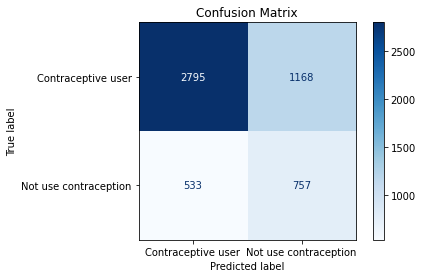

In [144]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_ann.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [145]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_ann.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [146]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_ann.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


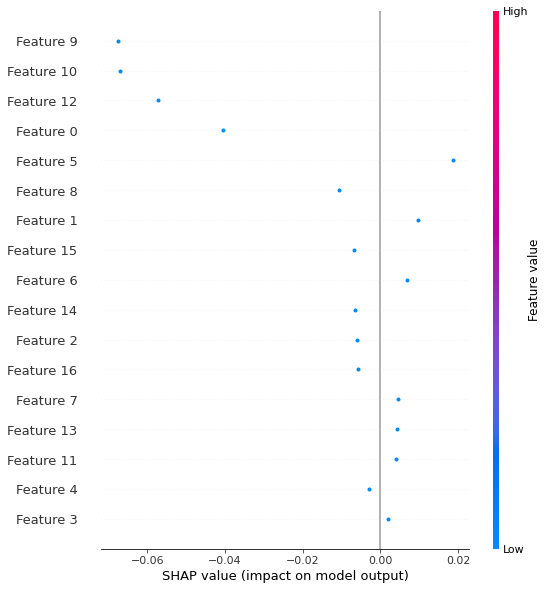

In [147]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_ann, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

In [ ]:
model_ann.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_27 (Dense)            (None, 64)                1152      
                                                                 
 dense_28 (Dense)            (None, 64)                4160      
                                                                 
 dense_29 (Dense)            (None, 1)                 65        
                                                                 
Total params: 5,377
Trainable params: 5,377
Non-trainable params: 0
_________________________________________________________________


165/165 [==============================] - 0s 1ms/step
              precision    recall  f1-score   support

           0       0.84      0.71      0.77      3963
           1       0.39      0.59      0.47      1290

    accuracy                           0.68      5253
   macro avg       0.62      0.65      0.62      5253
weighted avg       0.73      0.68      0.69      5253



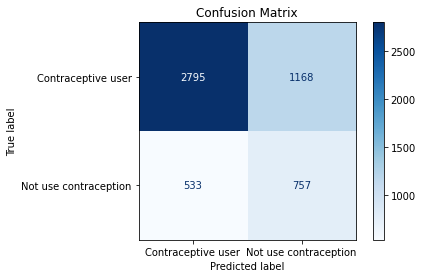

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_ann.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_ann.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_ann.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


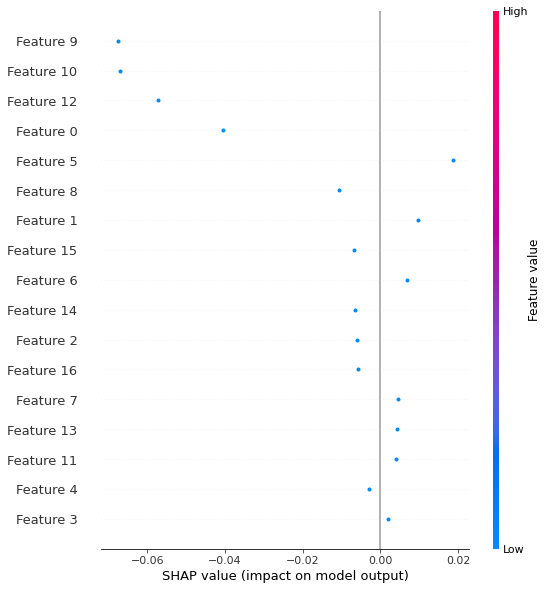

In [ ]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_ann, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)

In [224]:
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, Bidirectional, Conv1D, MaxPooling1D, GlobalMaxPooling1D,Dropout
from keras.callbacks import EarlyStopping

In [225]:
# Reshape the input data for LSTM and CNN
X_train2 = X_train1.reshape(X_train1.shape[0], X_train.shape[1], 1)
X_test1 = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)
X_val1 = X_val.reshape(X_val.shape[0], X_test.shape[1], 1)

In [226]:
# Define the input shape
input_shape = (X_train.shape[1], 1)

In [ ]:
# Define the LSTM model
model_lstm = Sequential([
  LSTM(64, input_shape=input_shape),
  Dropout(0.2),
  Dense(1, activation='sigmoid')
])

# Compile the model
model_lstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
history_an = model_lstm.fit(X_train1, y_train1, epochs=10, batch_size=8, validation_data=(X_val, y_val))

plt.plot(history_an.history['loss'], label='training loss')
plt.plot(history_an.history['val_loss'], label='validation loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

Epoch 1/10
1088/8921 [==>...........................] - ETA: 43s - loss: 0.6794 - accuracy: 0.5759

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get the predicted labels for the testing dataset
y_pred = model_lstm.predict(X_test)

# Convert the predicted probabilities to binary labels
y_pred_binary = [1 if p >= 0.5 else 0 for p in y_pred]

# Print the classification report
print(classification_report(y_test, y_pred_binary))

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred_binary)

# Plot the confusion matrix
cm_display = ConfusionMatrixDisplay(cm, display_labels=['Contraceptive user', 'Not use contraception'])
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
model_lstm.summary()

In [231]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_lstm.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 0
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 1s 2ms/step


In [232]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Define the model's predict function to return an array with two columns
def predict_fn(x):
    preds = model_lstm.predict(x)
    return np.column_stack((1 - preds, preds))

# Create the explainer object
explainer = LimeTabularExplainer(X_train, feature_names=df4.columns, class_names=['user', 'no'])

# Get a sample from the testing dataset
sample_idx = 3
x = X_test[sample_idx]

# Use LIME to explain the model's prediction for the sample
exp = explainer.explain_instance(x, predict_fn, num_features=16, labels=[1])
# Print the LIME explanation
exp.show_in_notebook(show_table=True)

157/157 [==============================] - 0s 2ms/step


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


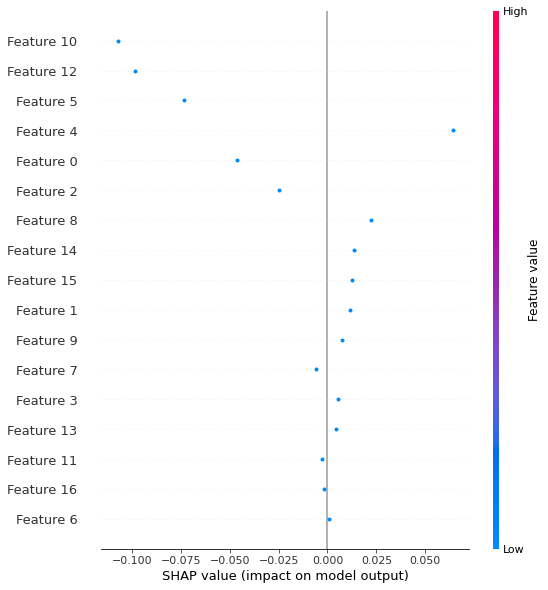

In [233]:

# Define the background dataset for SHAP values computation
background = X_train1[np.random.choice(X_train1.shape[0], 100, replace=False)]

# Compute SHAP values for a test example
explainer = shap.Explainer(model_ann, background)
shap_values = explainer(X_train1[0:1])

# Plot the SHAP values
shap.summary_plot(shap_values)